## Cellpose-SAM:

[paper](https://www.biorxiv.org/content/10.1101/2025.04.28.651001v1) | [code](https://github.com/MouseLand/cellpose)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Install Cellpose-SAM


In [ ]:
!pip install git+https://www.github.com/mouseland/cellpose.git

  Cloning https://www.github.com/mouseland/cellpose.git to /tmp/pip-req-build-o3_ismk6
  Running command git clone --filter=blob:none --quiet https://www.github.com/mouseland/cellpose.git /tmp/pip-req-build-o3_ismk6
  Resolved https://www.github.com/mouseland/cellpose.git to commit 79b0fcbf0296af8b021bcb812ff768d3e90aeb5d
  Preparing metadata (setup.py) ... done


Check GPU and instantiate model - will download weights.

In [ ]:
import numpy as np
from cellpose import models, core, io, plot
from pathlib import Path
from tqdm import trange
import matplotlib.pyplot as plt
from natsort import natsorted
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from skimage import measure

io.logger_setup() # run this to get printing of progress

model = models.CellposeModel(gpu=True)

2025-06-06 10:49:23,580 [INFO] WRITING LOG OUTPUT TO /root/.cellpose/run.log
2025-06-06 10:49:23,581 [INFO] 
cellpose version: 	4.0.5.dev16+g79b0fcb 
platform:       	linux 
python version: 	3.11.13 
torch version:  	2.6.0+cu124
2025-06-06 10:49:23,583 [INFO] ** TORCH CUDA version installed and working. **
2025-06-06 10:49:23,583 [INFO] >>>> using GPU (CUDA)
2025-06-06 10:49:25,732 [INFO] >>>> loading model /root/.cellpose/models/cpsam


Input directory with your images:

In [ ]:
# *** change to your google drive folder path ***
dir = "/content/drive/MyDrive/Afstudeerproject/E35_tif"
dir = Path(dir)
if not dir.exists():
  raise FileNotFoundError("directory does not exist")

# *** change to your image extension ***
image_ext = ".tif"

# list all files
files = natsorted([f for f in dir.glob("*"+image_ext) if "_masks" not in f.name and "_flows" not in f.name])

if(len(files)==0):
  raise FileNotFoundError("no image files found, did you specify the correct folder and extension?")
else:
  print(f"{len(files)} images in folder:")

for f in files:
  print(f.name)

20 images in folder:
20240312_CKR_Exp35_STHdhQ97HA_96h_+BafA_CCT1_635P_HA_580_A11_460L_1.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+BafA_CCT1_635P_HA_580_A11_460L_2.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+BafA_CCT1_635P_HA_580_A11_460L_3.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+BafA_CCT1_635P_HA_580_A11_460L_4.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+BafA_CCT1_635P_HA_580_A11_460L_5.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+MG132_CCT1_635P_HA_580_A11_460L_1.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+MG132_CCT1_635P_HA_580_A11_460L_2.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+MG132_CCT1_635P_HA_580_A11_460L_3.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+MG132_CCT1_635P_HA_580_A11_460L_4.tif
20240312_CKR_Exp35_STHdhQ97HA_96h_+MG132_CCT1_635P_HA_580_A11_460L_5.tif
20242911_CKR_Exp35_STHdhQ97HA_72h_+bafCCT1_635P_HA_580_A11_460L_1.tif
20242911_CKR_Exp35_STHdhQ97HA_72h_+bafCCT1_635P_HA_580_A11_460L_2.tif
20242911_CKR_Exp35_STHdhQ97HA_72h_+bafCCT1_635P_HA_580_A11_460L_3.tif
20242911_CKR_Exp35_STHdhQ97HA_72h_+bafCCT1_6

In [ ]:
img = io.imread(files[2])
print(img.shape)

2025-06-06 10:49:29,345 [INFO] reading tiff with 44 planes


100%|██████████| 44/44 [00:00<00:00, 340.28it/s]

(11, 4, 1024, 1024)


In [ ]:
# file_path = "/Users/demir/Documents/Hva_AI/afstudeerproject/E35_tif/20240312_CKR_Exp35_STHdhQ97HA_96h_+BafA_CCT1_635P_HA_580_A11_460L_1.tif"
# img = io.imread(file_path) # (9, 4, 1024, 1024)
print(f'img       : {img.shape}')

img_nuclei = img[:, 0, :, :]
img_aggregate = img[:, 2, :, :]
img_cellbody = img[:, 3, :, :]

print(f'Nuclei    : {img_nuclei.shape} \nAggregate : {img_aggregate.shape} \nCell body : {img_cellbody.shape}')

img       : (11, 4, 1024, 1024)
Nuclei    : (11, 1024, 1024) 
Aggregate : (11, 1024, 1024) 
Cell body : (11, 1024, 1024)


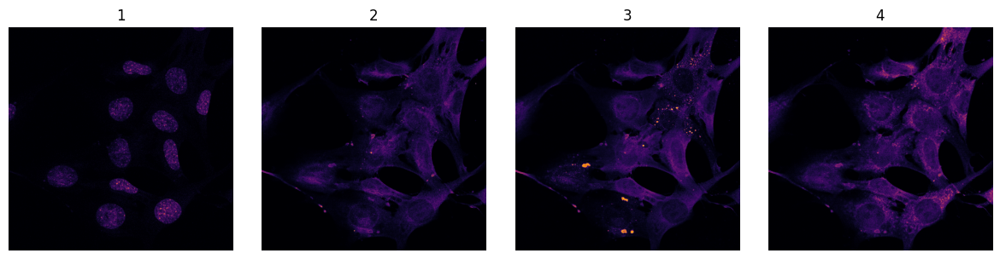

In [ ]:
import matplotlib.pyplot as plt

mid = img.shape[0] // 2
titles = ["1", "2", "3", "4"]

plt.figure(figsize=(12, 3))
for i in [0, 1, 2, 3]:
    plt.subplot(1, 4, i+1)
    plt.imshow(img[mid, i], cmap='inferno')
    plt.title(titles[i])
    plt.axis("off")
plt.tight_layout()
plt.show()

In [ ]:
# Function to process each Z-slice for a given channel
def process_channel(img, channel_idx, diameter, threshold_factor=0.4):
    channel_img = img[:, channel_idx, :, :]
    print(f'Channel {channel_idx} shape: {channel_img.shape}')

    # Create an empty list to hold the masks for each Z-slice
    masks = []

    for z_slice in range(channel_img.shape[0]):
        slice_img = channel_img[z_slice, :, :]

        masks_z, _, _ = model.eval(
            slice_img,
            batch_size=8,
            flow_threshold=0.4,
            cellprob_threshold=0.0,
            diameter=diameter
        )
        masks.append(masks_z)

    return masks

# Process nuclei (Channel 1)
nuclei_masks = process_channel(img, 0, diameter=25) # 4,5 minute - diameter 50 : 9 min -diameter 30

# Process cell bodies (Channel 3)
cellbody_masks = process_channel(img, 3, diameter=100) # 1,5 minute


Channel 0 shape: (11, 1024, 1024)
2025-06-06 10:49:39,337 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:49:48,451 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:49:57,758 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:50:06,993 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:50:16,168 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:50:25,295 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:50:34,438 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:50:43,477 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:50:52,463 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:51:01,459 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:51:10,424 [WARNING] Resizing is depricated in v4.0.1+
Channel 3 shape: (11, 1024, 1024)
2025-06-06 10:51:13,620 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:51:16,834 [WARNING] Resizing is depricated in v4.0.1+
2025-06-06 10:51:20,030 [WARNING] Resizing is de

In [ ]:
from skimage import morphology
# Process aggregates (Channel 2)
from scipy.ndimage import label
from skimage.measure import regionprops

def process_aggregates(img):
    aggregate_masks = []
    for z_slice in range(img.shape[0]):
        slice_img = img[z_slice, 2, :, :]  # Channel 2 for aggregates
        threshold = 0.6 * np.max(slice_img)
        bright_spots = slice_img > threshold
        clean_mask = morphology.remove_small_objects(bright_spots, min_size=10)
        aggregate_masks.append(clean_mask)
    return aggregate_masks

aggregate_masks = process_aggregates(img)

aggregate_stack = np.stack(aggregate_masks, axis=0)  # shape: (Z, Y, X)
labeled_aggregates, num_aggregates = label(aggregate_stack)

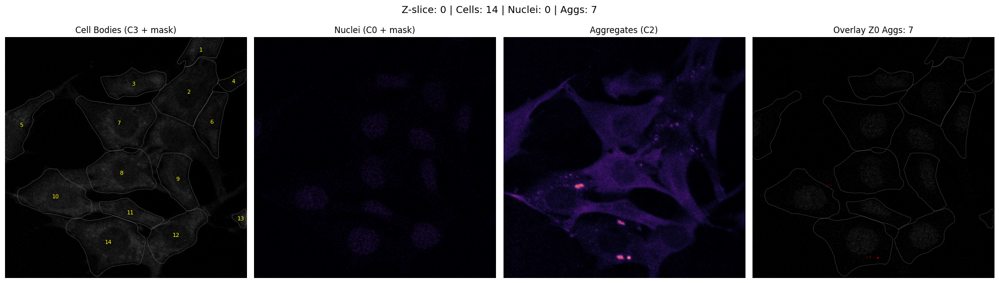

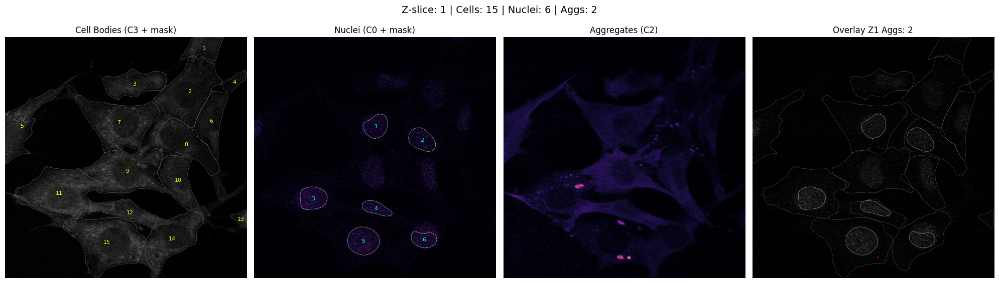

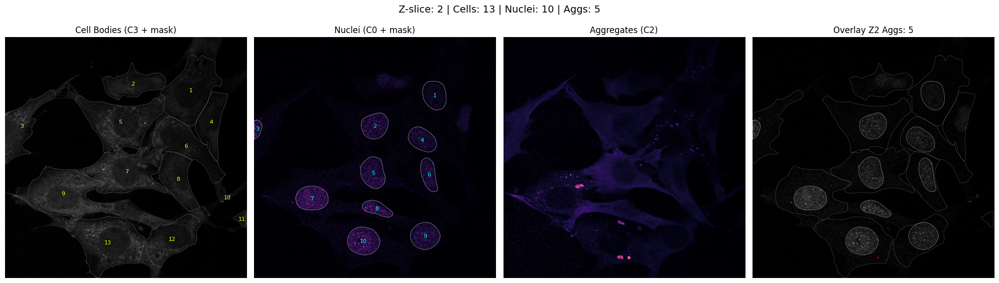

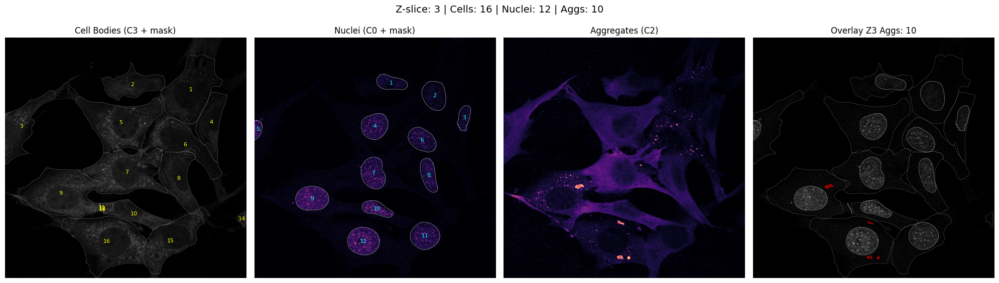

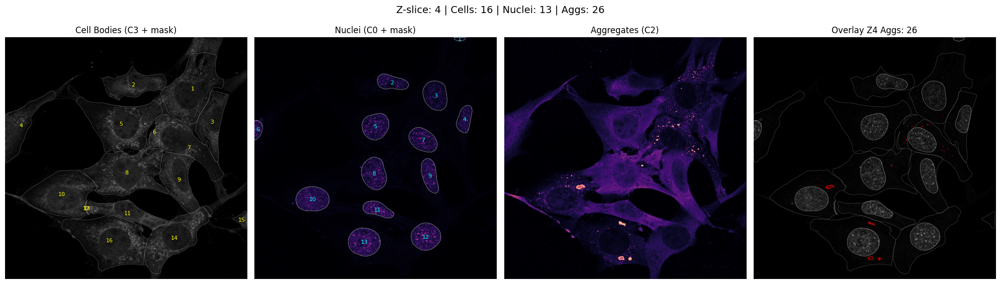

...

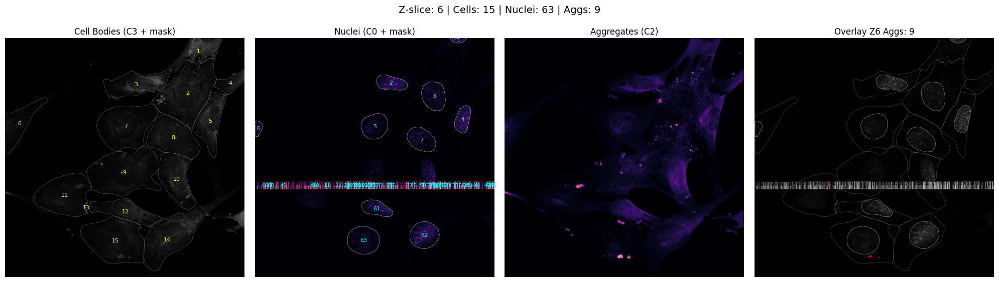

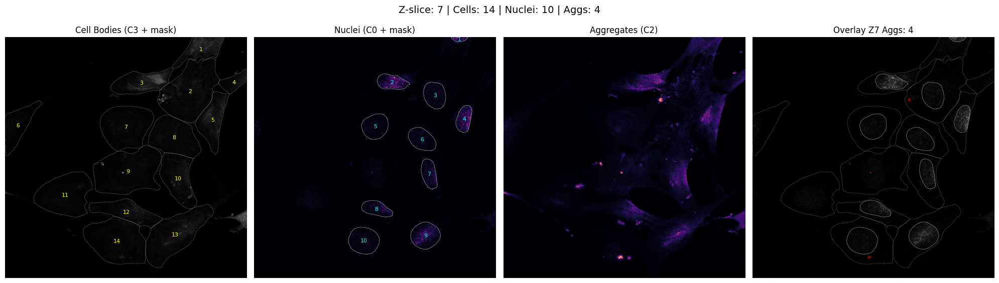

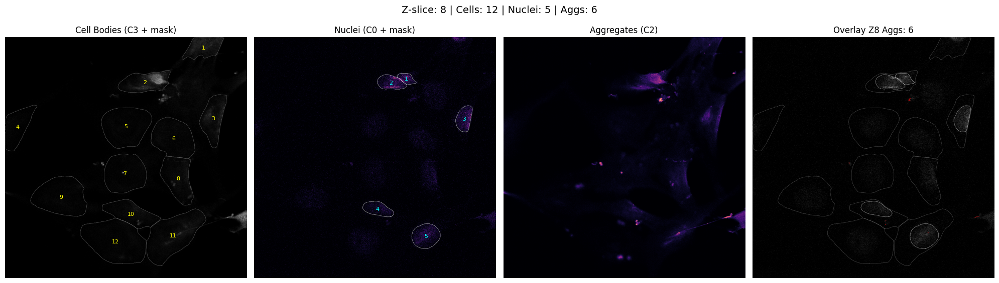

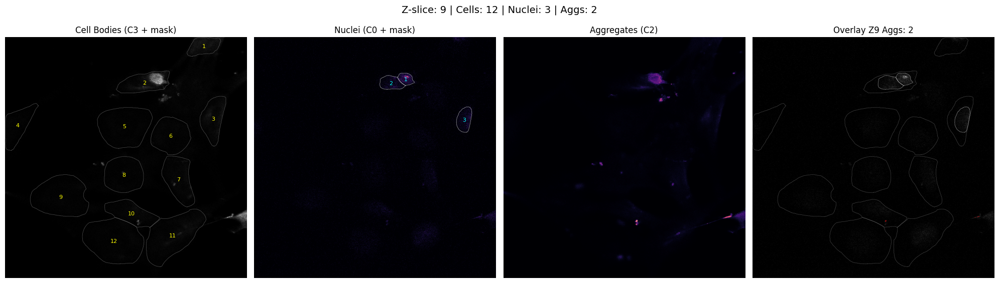

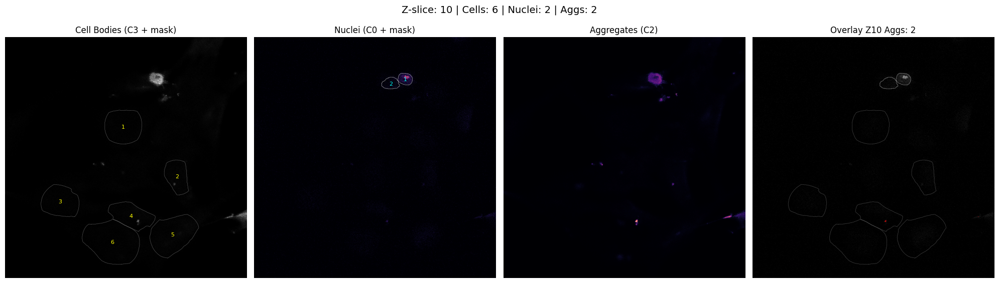

✅ Saved to all_overlays.pdf


In [ ]:
from matplotlib.backends.backend_pdf import PdfPages
from skimage import measure


def plot_gray_overlay_with_nuclei(img, cellbody_masks, nuclei_masks, labeled_aggregates):
    pdf_path = "all_overlays.pdf"
    with PdfPages(pdf_path) as pdf:
        for z in range(img.shape[0]):
            c0, c2, c3 = img[z, 0], img[z, 2], img[z, 3]
            cell_mask = cellbody_masks[z]
            nuclei_mask = nuclei_masks[z]
            agg_mask = labeled_aggregates[z]

            fig, axs = plt.subplots(1, 4, figsize=(20, 6))
            titles = ['Nuclei (C0 + mask)', 'Aggregates (C2)', 'Cell Bodies (C3 + mask)', 'Overlay']
            images = [c0, c2, c3]

            # 1. subplot - C3 + cellbody mask
            axs[0].imshow(c3, cmap='gray')
            for i, region in enumerate(measure.regionprops(cell_mask)):
              y, x = region.centroid
              axs[0].text(x, y, str(i + 1), color='yellow', fontsize=8, ha='center', va='center')
              for c in measure.find_contours(cell_mask == region.label, 0.5):
                axs[0].plot(c[:, 1], c[:, 0], color='gray', linewidth=0.5, alpha=0.6)
            axs[0].set_title(titles[2])
            axs[0].axis('off')

            # 2. subplot - C0 + nuclei mask
            axs[1].imshow(c0, cmap='magma')
            for i, region in enumerate(measure.regionprops(nuclei_mask)):
              for c in measure.find_contours(nuclei_mask == region.label, 0.5):
                axs[1].plot(c[:, 1], c[:, 0], color='white', linewidth=0.5, alpha=0.6)
              y, x = region.centroid
              axs[1].text(x, y, str(i + 1), color='cyan', fontsize=8, ha='center', va='center')
            axs[1].set_title(titles[0])
            axs[1].axis('off')

            # 3. subplot - C2
            axs[2].imshow(c2, cmap='magma')
            axs[2].set_title(titles[1])
            axs[2].axis('off')

            # 4. subplot - Overlay (C0 + masks + red aggregates)
            axs[3].imshow(c0, cmap='gray')
            for region in measure.regionprops(cell_mask):
                for c in measure.find_contours(cell_mask == region.label, 0.5):
                    axs[3].plot(c[:, 1], c[:, 0], color='gray', linewidth=0.5, alpha=0.5)
            for region in measure.regionprops(nuclei_mask):
                for c in measure.find_contours(nuclei_mask == region.label, 0.5):
                    axs[3].plot(c[:, 1], c[:, 0], color='white', linewidth=0.5, alpha=0.5)

            red = np.zeros((*agg_mask.shape, 4))
            red[agg_mask > 0] = [1, 0, 0, 0.7]
            axs[3].imshow(red)
            axs[3].set_title(f"{titles[3]} Z{z} Aggs: {len(regionprops(agg_mask))}")
            axs[3].axis('off')

            fig.suptitle(f"Z-slice: {z} | Cells: {len(np.unique(cell_mask))-1} | "
                         f"Nuclei: {len(np.unique(nuclei_mask))-1} | "
                         f"Aggs: {len(regionprops(agg_mask))}", fontsize=14)

            fig.tight_layout()
            pdf.savefig(fig)
            plt.show()
            plt.close()

    print(f"✅ Saved to {pdf_path}")

plot_gray_overlay_with_nuclei(img, cellbody_masks, nuclei_masks, labeled_aggregates)



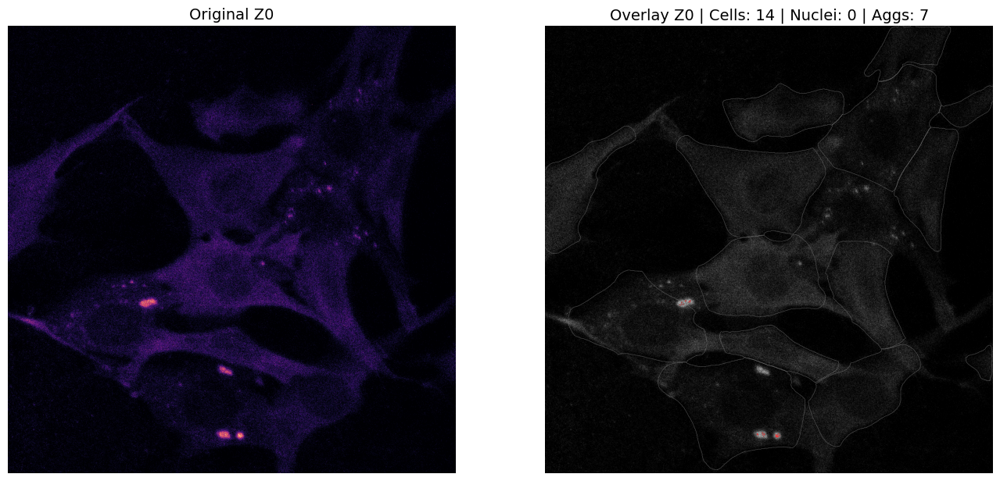

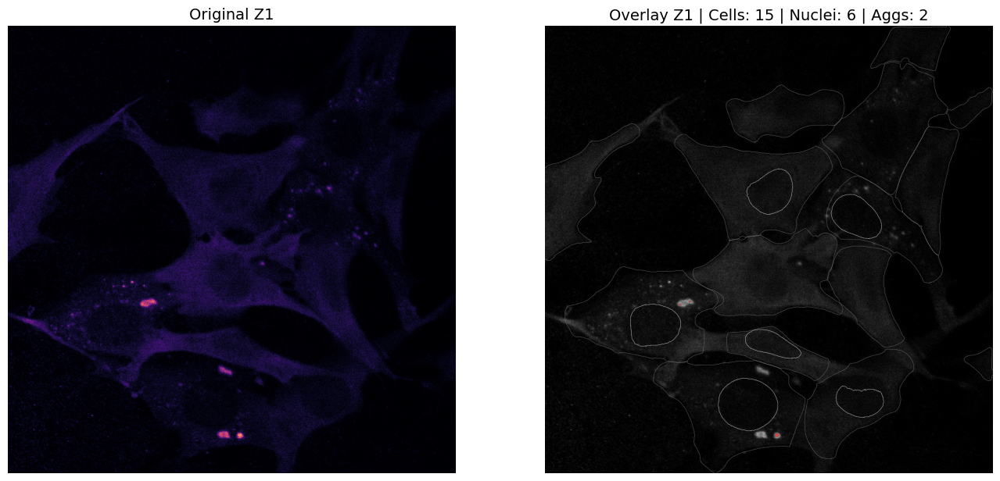

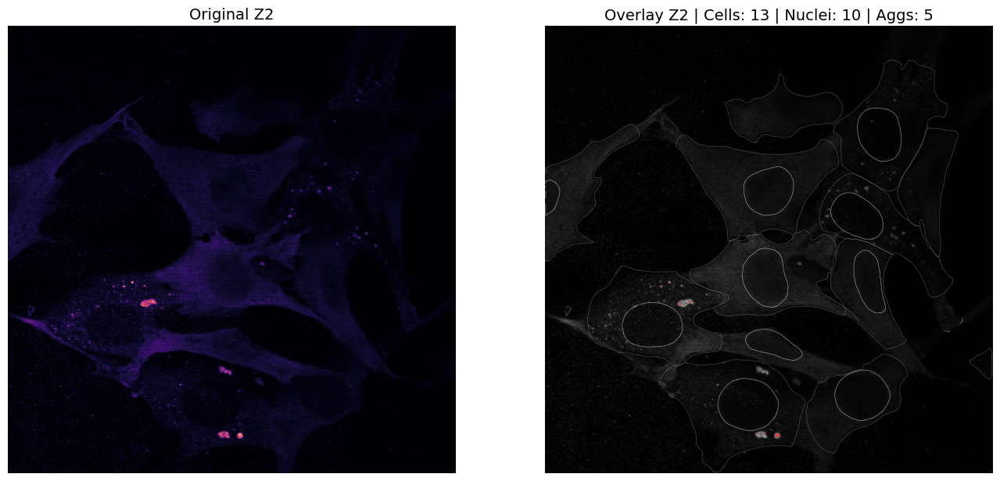

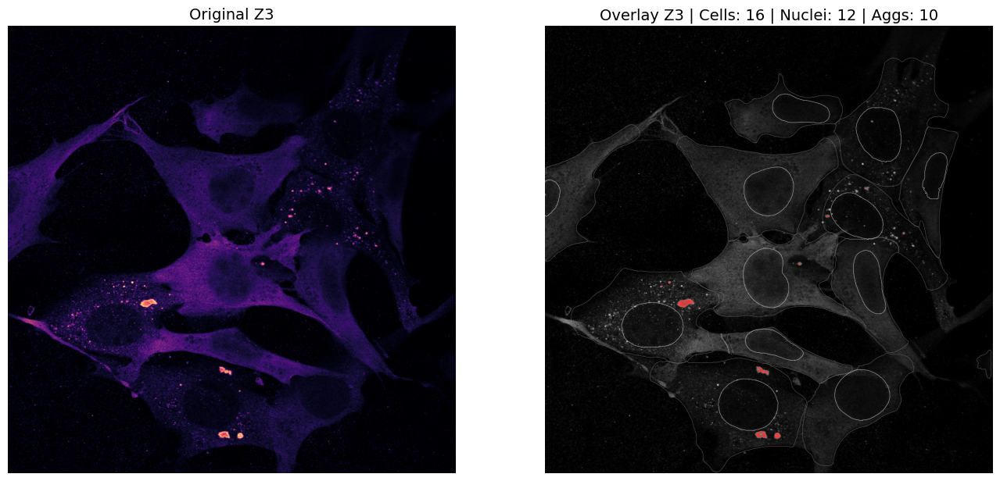

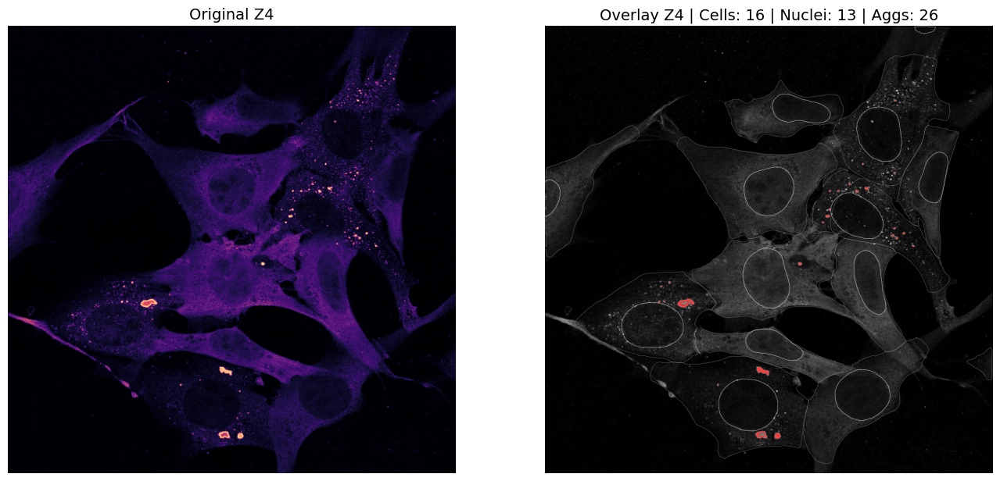

...

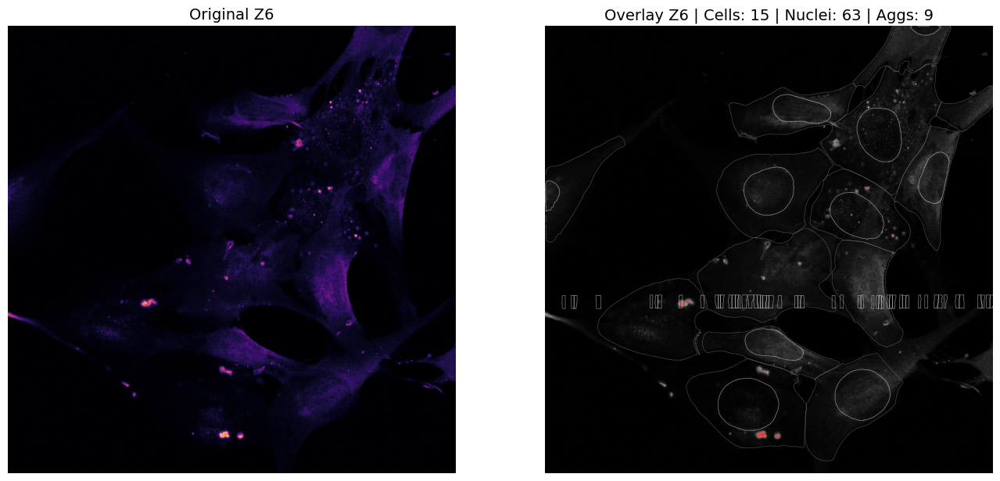

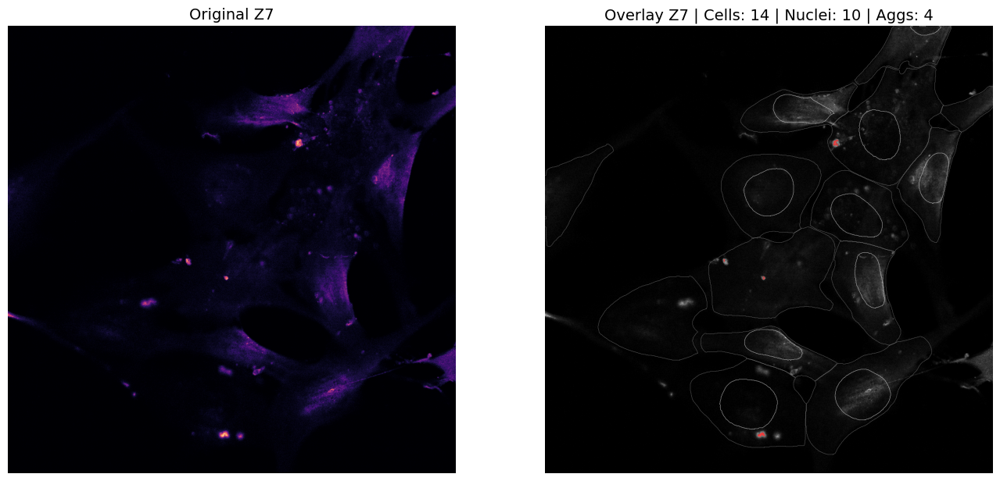

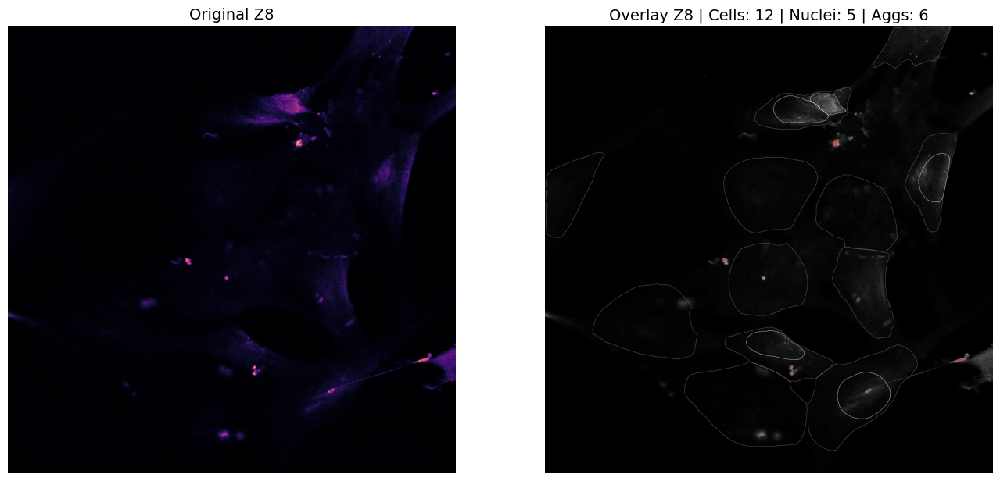

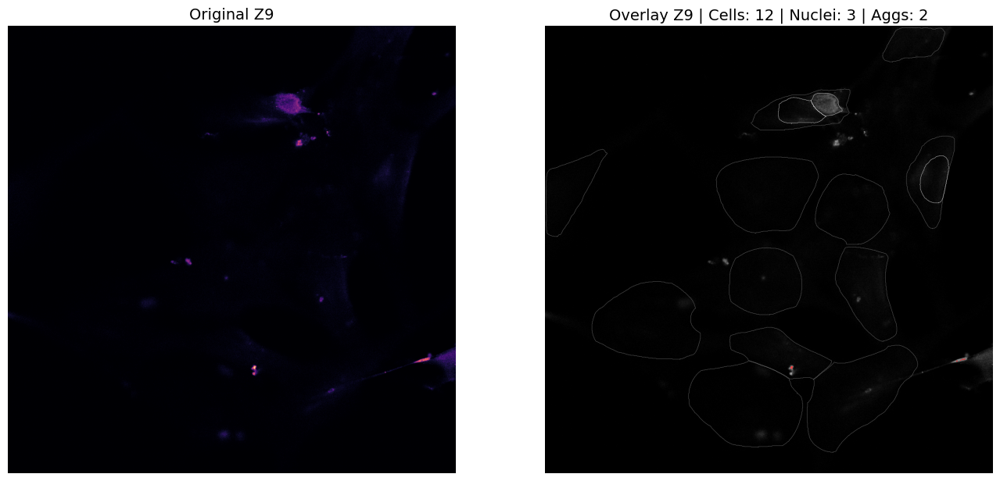

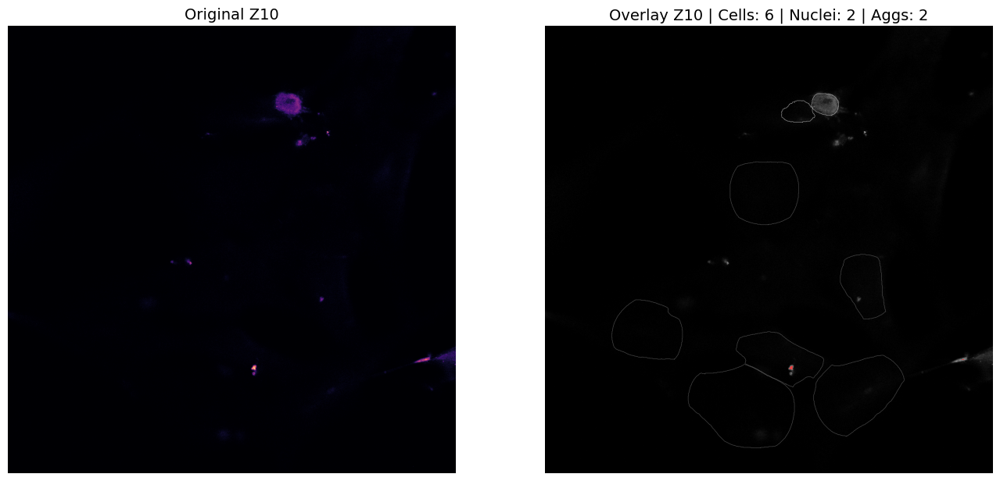

✅ All slices saved to all_overlays_big.pdf


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
from skimage import measure

def draw_contours(ax, mask, color):
    for region in measure.regionprops(mask):
        for coords in measure.find_contours(mask == region.label, 0.5):
            ax.plot(coords[:, 1], coords[:, 0], color=color, linewidth=0.5, alpha=0.5)

def plot_gray_overlay_with_nuclei(img, cellbody_masks, nuclei_masks, labeled_aggregates):
    pdf_path = "all_overlays_big.pdf"

    with PdfPages(pdf_path) as pdf:
        for z in range(img.shape[0]):
            base_img = img[z, 2]  # Aggregate kanalı (C2)
            cell_mask = cellbody_masks[z]
            nuclei_mask = nuclei_masks[z]
            agg_mask = labeled_aggregates[z]

            fig, axs = plt.subplots(1, 2, figsize=(14, 7))
            axs[0].imshow(base_img, cmap='magma')
            axs[0].set_title(f"Original Z{z}", fontsize=14)
            axs[0].axis('off')

            axs[1].imshow(base_img, cmap='gray')
            draw_contours(axs[1], cell_mask, 'gray')
            draw_contours(axs[1], nuclei_mask, 'white')

            red_overlay = np.zeros((*agg_mask.shape, 4))
            red_overlay[agg_mask > 0] = [1, 0, 0, 0.7]
            axs[1].imshow(red_overlay)

            axs[1].set_title(f"Overlay Z{z} | Cells: {len(np.unique(cell_mask))-1} | "
                             f"Nuclei: {len(np.unique(nuclei_mask))-1} | "
                             f"Aggs: {len(measure.regionprops(agg_mask))}", fontsize=14)
            axs[1].axis('off')

            fig.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.05)
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            plt.close()

    print(f"✅ All slices saved to {pdf_path}")
plot_gray_overlay_with_nuclei(img, cellbody_masks, nuclei_masks, labeled_aggregates)


In [ ]:
import numpy as np
import pandas as pd
from skimage.measure import regionprops, label
from scipy.ndimage import binary_dilation, label as ndi_label

def analyze_aggregates_3d_with_2d_shape_features(img, cellbody_masks, nuclei_masks, labeled_aggregates, perinuclear_margin=10):
    # 3D bağlantılı bileşen analizi (0: background)
    labeled_3d, num_features = ndi_label(labeled_aggregates > 0)

    nucleus_channel_idx = 0
    aggregate_channel_idx = 2
    cellbody_channel_idx = 3

    all_results = []

    for label_id in range(1, num_features + 1):
        coords_3d = np.argwhere(labeled_3d == label_id)
        z_slices = np.unique(coords_3d[:, 0])

        eccs, circs, solids = [], [], []
        overlaps_nuc, overlaps_peri = [], []
        intensities = {'aggregate': [], 'nucleus': [], 'cellbody': []}

        for z in z_slices:
            mask_agg_2d = (labeled_3d[z] == label_id).astype(np.uint8)
            props = regionprops(mask_agg_2d, intensity_image=img[z, aggregate_channel_idx])

            if not props:
                continue  # skip empty slices

            region = props[0]
            coords = region.coords

            # 2D shape features
            try:
                circ = 4 * np.pi * region.area / (region.perimeter**2 + 1e-6)
                circularity = circ if circ <= 1.2 else np.nan
            except:
                circularity = np.nan
            # circ = 4 * np.pi * region.area / (region.perimeter**2 + 1e-6)
            # circs.append(circ)

            circs.append(circularity)
            eccs.append(region.eccentricity)
            solids.append(region.solidity)

            # Masks
            nuc_mask = nuclei_masks[z].astype(bool)
            cell_mask = cellbody_masks[z].astype(bool)

            nuclei_dilated = binary_dilation(nuc_mask, iterations=perinuclear_margin)
            perinuclear_mask = nuclei_dilated & (~nuc_mask)

            overlap_nuc = np.sum(nuc_mask[coords[:, 0], coords[:, 1]]) / region.area
            overlap_peri = np.sum(perinuclear_mask[coords[:, 0], coords[:, 1]]) / region.area

            overlaps_nuc.append(overlap_nuc)
            overlaps_peri.append(overlap_peri)

            for ch_name, ch_idx in zip(['aggregate', 'nucleus', 'cellbody'],
                                       [aggregate_channel_idx, nucleus_channel_idx, cellbody_channel_idx]):
                mean_val = np.mean(img[z, ch_idx, coords[:, 0], coords[:, 1]])
                intensities[ch_name].append(mean_val)

            mean_circularity = np.nan
            if len(circs) > 0 and not all(np.isnan(circs)):
                mean_circularity = round(np.nanmean(circs), 2)


        # Ortalama hesapla
        res = {
            'aggregate_3d_label': label_id,
            'z_start': int(z_slices.min()),
            'z_end': int(z_slices.max()),
            'mean_eccentricity': round(np.nanmean(eccs), 2),
            'mean_solidity': round(np.nanmean(solids), 2),
            'mean_circularity': mean_circularity,
            'mean_overlap_nucleus': round(np.nanmean(overlaps_nuc), 2),
            'mean_overlap_perinuclear': round(np.nanmean(overlaps_peri), 2)
        }
        for k in intensities:
            res[f'mean_intensity_{k}'] = round(np.nanmean(intensities[k]), 2)

        # Lokalizasyon kararı (sadece ortalama üzerinden)
        if res['mean_overlap_nucleus'] > 0.5:
            res['location'] = 'nuclear'
        elif res['mean_overlap_perinuclear'] > 0.5:
            res['location'] = 'perinuclear'
        else:
            res['location'] = 'cytoplasmic'

        all_results.append(res)


    df = pd.DataFrame(all_results)
    df.to_csv('aggregate_analysis_3d_simplified.csv', index=False)
    return df

df = analyze_aggregates_3d_with_2d_shape_features(img, cellbody_masks, nuclei_masks, labeled_aggregates)

import IPython.display as disp
disp.display(df.style.hide(axis='index'))

aggregate_3d_label,z_start,z_end,mean_eccentricity,mean_solidity,mean_circularity,mean_overlap_nucleus,mean_overlap_perinuclear,mean_intensity_aggregate,mean_intensity_nucleus,mean_intensity_cellbody,location
1,0,0,0.720000,0.650000,nan,0.000000,0.000000,5497.770000,154.690000,1195.620000,cytoplasmic
2,0,6,0.950000,0.520000,0.350000,0.040000,0.060000,32662.590000,2440.610000,9470.930000,cytoplasmic
3,0,0,0.910000,0.620000,0.990000,0.000000,0.000000,5221.400000,15.270000,1617.530000,cytoplasmic
4,0,0,0.600000,0.710000,nan,0.000000,0.000000,5068.200000,227.600000,1687.500000,cytoplasmic
5,0,0,0.770000,0.610000,0.390000,0.000000,0.000000,5373.330000,143.510000,1161.360000,cytoplasmic
6,0,0,0.800000,0.820000,0.940000,0.000000,0.000000,5401.390000,292.440000,1050.170000,cytoplasmic
7,0,6,0.550000,0.870000,0.760000,0.000000,0.000000,34267.730000,785.450000,8368.110000,cytoplasmic
8,2,4,0.530000,0.980000,nan,0.000000,0.000000,44172.780000,1053.890000,13291.950000,cytoplasmic
9,2,4,0.740000,1.000000,nan,0.000000,0.000000,42235.680000,1151.620000,12732.570000,cytoplasmic
10,2,7,0.840000,0.700000,0.420000,0.000000,0.170000,41106.190000,1227.170000,10146.720000,cytoplasmic


In [ ]:
def categorize_shape_descriptor(eccentricity, circularity):
    if eccentricity > 0.85 and circularity < 0.4:
        return "elongated"
    elif 0.6 < eccentricity <= 0.85 or 0.4 <= circularity < 0.7:
        return "irregular"
    else:
        return "circular"

def categorize_solidity(sol):
    if sol >= 0.9:
        return "smooth"
    else:
        return "irregular"


df_filtered = df.copy()

df_filtered["solidity"] = df_filtered["mean_solidity"].apply(categorize_solidity)

df_filtered["shape"] = df_filtered.apply(
    lambda row: categorize_shape_descriptor(row["mean_eccentricity"], row["mean_circularity"]),
    axis=1
)
df_filtered["intensity"] = (df_filtered["mean_intensity_aggregate"] / 65535).round(2)
# df_filtered["mean_intensity_aggregate_norm"] = (df_filtered["mean_intensity_aggregate"] / 1000).round(1)

columns_to_keep = [
    "aggregate_3d_label", "z_start", "z_end", "location",
    "shape", "solidity", "intensity"
]

df_filtered = df_filtered[columns_to_keep]

df_filtered.to_csv('aggregate_analysis_3d_simplified.csv', index=False)

# Tüm tabloyu güzel formatta görmek istersen
import IPython.display as disp
disp.display(df_filtered.style.hide(axis='index'))

aggregate_3d_label,z_start,z_end,location,shape,solidity,intensity
1,0,0,cytoplasmic,irregular,irregular,0.080000
2,0,6,cytoplasmic,elongated,irregular,0.500000
3,0,0,cytoplasmic,circular,irregular,0.080000
4,0,0,cytoplasmic,circular,irregular,0.080000
5,0,0,cytoplasmic,irregular,irregular,0.080000
6,0,0,cytoplasmic,irregular,irregular,0.080000
7,0,6,cytoplasmic,circular,irregular,0.520000
8,2,4,cytoplasmic,circular,smooth,0.670000
9,2,4,cytoplasmic,irregular,smooth,0.640000
10,2,7,cytoplasmic,irregular,irregular,0.630000


In [ ]:
# # nuclei_masks ve cellbody_masks liste halinde (Z dilimi, H, W)
# nuclei_3d = np.stack(nuclei_masks, axis=0)       # (Z, H, W)
# cellbody_3d = np.stack(cellbody_masks, axis=0)   # (Z, H, W)

# # Kaydet
# np.save("nuclei_masks_3d.npy", nuclei_3d)
# np.save("cellbody_masks_3d.npy", cellbody_3d)

# np.save('/content/drive/MyDrive/Afstudeerproject/nuclei_masks_3d.npy', nuclei_3d)
# np.save('/content/drive/MyDrive/Afstudeerproject/cellbody_masks_3d.npy', cellbody_3d)



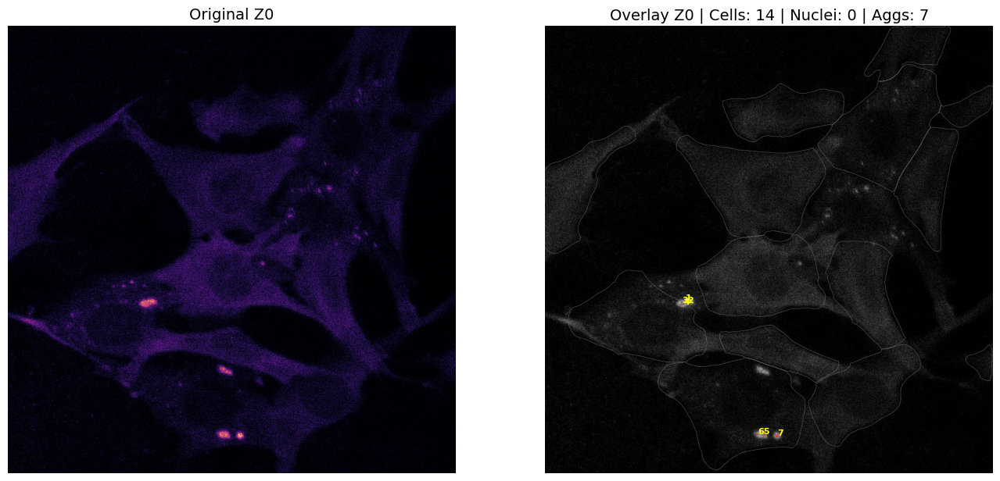

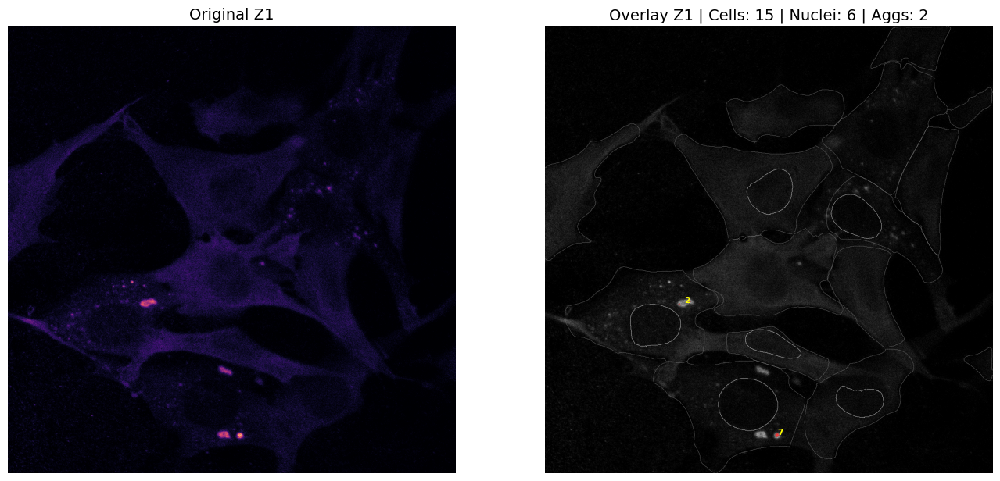

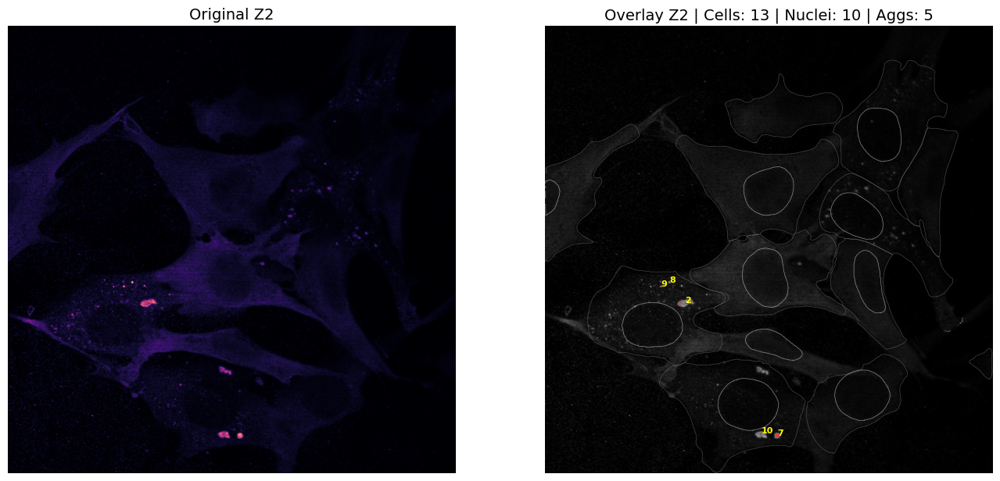

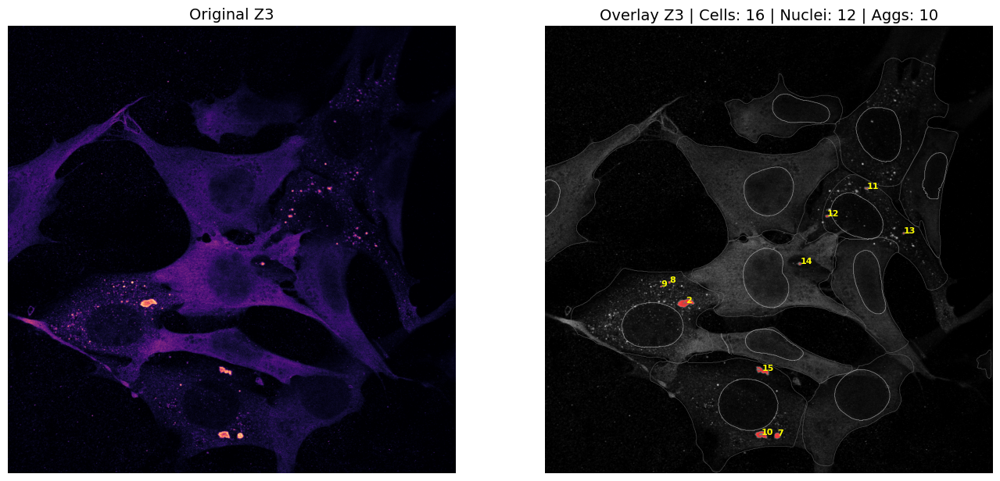

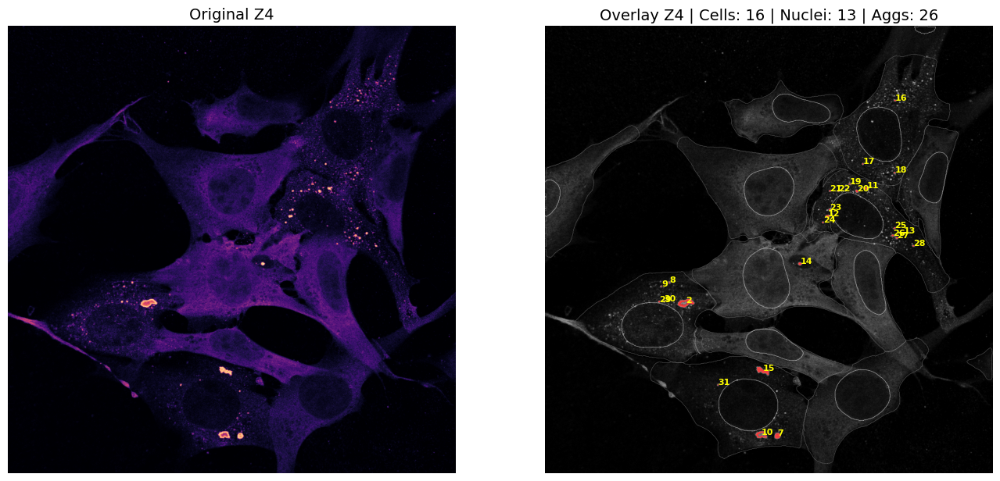

...

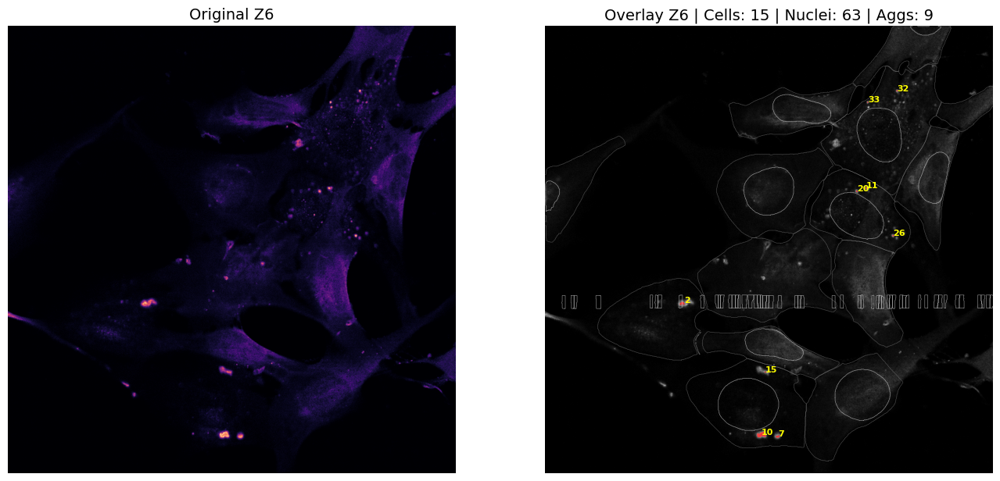

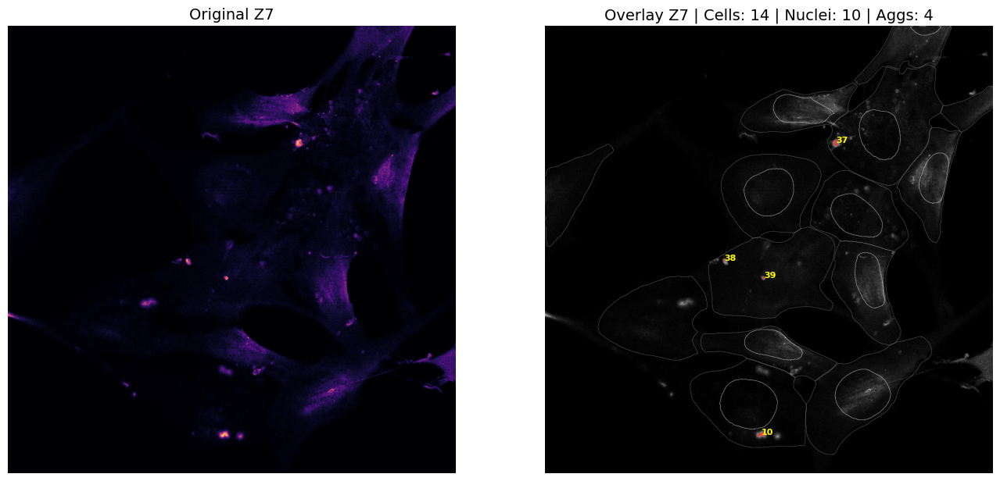

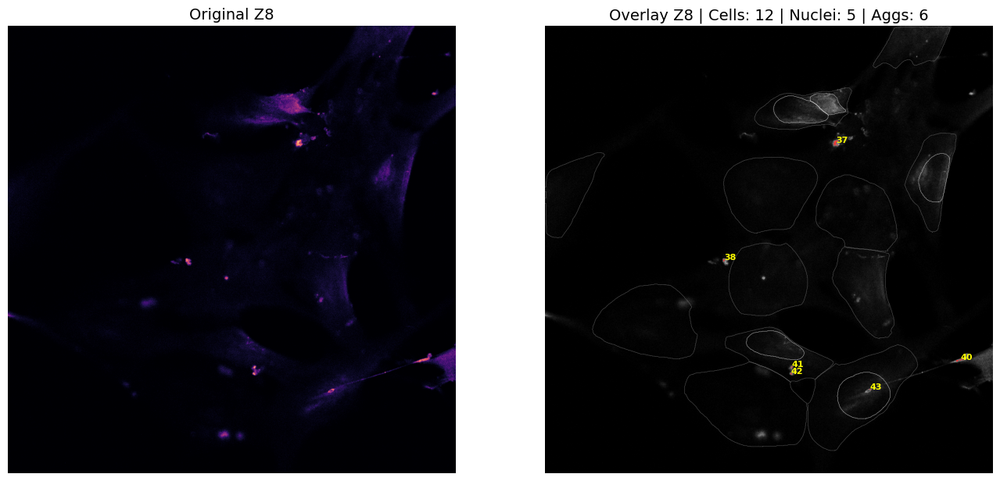

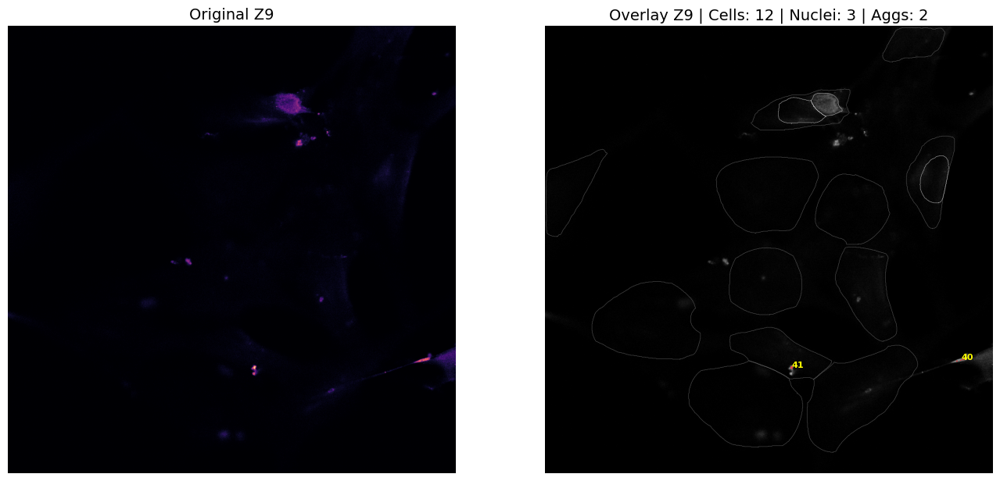

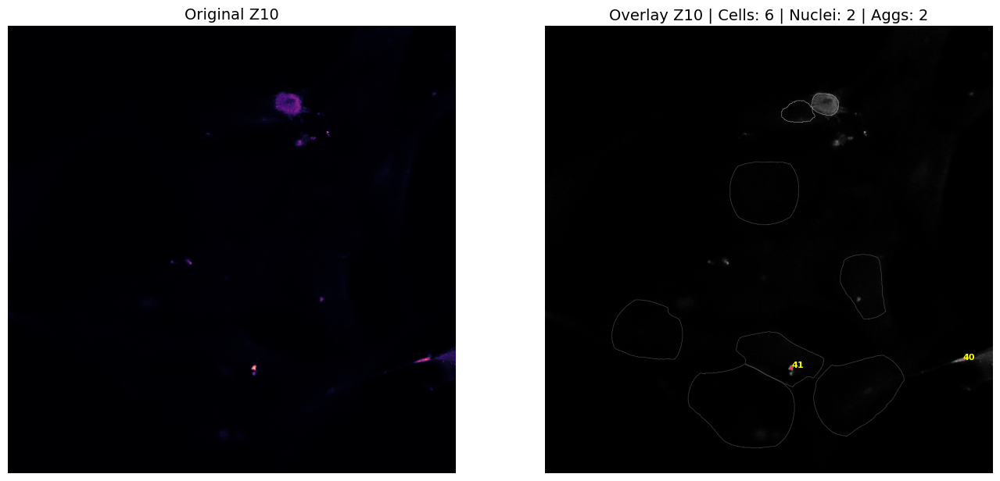

✅ All slices saved to aggregate_3d_global_labeled.pdf


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
from skimage import measure

def draw_global_labels_on_slice(ax, labeled_3d_slice, color='yellow'):
    # unique agregatlar o slice içinde
    labels_in_slice = np.unique(labeled_3d_slice)
    labels_in_slice = labels_in_slice[labels_in_slice != 0]  # background hariç

    for label_id in labels_in_slice:
        # o label'a ait pixel koordinatları
        coords = np.argwhere(labeled_3d_slice == label_id)
        if coords.size == 0:
            continue
        y0, x0 = np.mean(coords, axis=0)
        ax.text(x0, y0, str(label_id), color=color, fontsize=8, fontweight='bold')

def plot_3d_global_labels_overlay(img, cellbody_masks, nuclei_masks, labeled_aggregates_3d):
    pdf_path = "aggregate_3d_global_labeled.pdf"

    with PdfPages(pdf_path) as pdf:
        for z in range(img.shape[0]):
            base_img = img[z, 2]  # Aggregate kanalı (C2)
            cell_mask = cellbody_masks[z]
            nuclei_mask = nuclei_masks[z]
            agg_mask_3d_slice = labeled_aggregates_3d[z]

            # Slice içindeki agregat sayısı (benzersiz 3D global label)
            unique_agg_labels = np.unique(agg_mask_3d_slice)
            unique_agg_labels = unique_agg_labels[unique_agg_labels != 0]  # background exclude

            fig, axs = plt.subplots(1, 2, figsize=(14, 7))
            axs[0].imshow(base_img, cmap='magma')
            axs[0].set_title(f"Original Z{z}", fontsize=14)
            axs[0].axis('off')

            axs[1].imshow(base_img, cmap='gray')
            # Hücre ve çekirdek konturları
            for mask, c in zip([cell_mask, nuclei_mask], ['gray', 'white']):
                for region in measure.regionprops(mask):
                    for contour in measure.find_contours(mask == region.label, 0.5):
                        axs[1].plot(contour[:, 1], contour[:, 0], color=c, linewidth=0.5, alpha=0.5)

            # Agregatların kırmızı transparan overlay'i (mask: >0 ise kırmızı)
            red_overlay = np.zeros((*agg_mask_3d_slice.shape, 4))
            red_overlay[agg_mask_3d_slice > 0] = [1, 0, 0, 0.7]
            axs[1].imshow(red_overlay)

            # 3D global label'ları o slice içindeki pozisyonlara yaz
            draw_global_labels_on_slice(axs[1], agg_mask_3d_slice, color='yellow')

            axs[1].set_title(f"Overlay Z{z} | Cells: {len(np.unique(cell_mask)) - 1} | "
                             f"Nuclei: {len(np.unique(nuclei_mask)) - 1} | "
                             f"Aggs: {len(unique_agg_labels)}", fontsize=14)
            axs[1].axis('off')

            fig.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.05)
            pdf.savefig(fig, bbox_inches='tight')
            plt.show()
            plt.close()

    print(f"✅ All slices saved to {pdf_path}")

# Çağır
plot_3d_global_labels_overlay(img, cellbody_masks, nuclei_masks, labeled_aggregates)
